# Goal

Chris Lintott, David O'Ryan and myself (Tobias Géron) spent 5 nights on the INT at the end of September 2022. However, due to storm Hermine, we were only able to observe one target. We were also able to take multiple calibration frames. The target, which is a strongly barred galaxy, was observed with the INT using the IDS spectrograph. We used the R300V grating and the EEV10 detector. We observed the target using a slit placed parallel to the bar and a slit placed perpendicular to the bar. 

The SDSS objid of the target is 587727223561584734  
RA: 00 05 24.1267  
DEC: +16 02 59.9322  

In this notebook, I will go through the different steps in the data reduction using the ccdproc library in Python. I visualise every step along the way.



Useful links:    
ccdproc: https://ccdproc.readthedocs.io/en/latest/  
Other repo that does INT reduction: https://github.com/aayush3009/INT-IDS-DataReduction  




A note on the different files:  
The images are stored under data_telescope/20220923/.  
On-bar science images: 1633271, 1633274, 1633275, 1633276  
Off-bar science images: 1633277, 1633279, 1633280, 1633281  
Bias frames: 1633188 to 1633208  
Flatfields: 1633209 to 1633219  
Arcs: 1633221 to 1633233   
Standard star: /SP2032+248/1688601 to 1688605. Note that these are from the night 




# Imports

In [1]:
import numpy as np 
from astropy.io import fits 
from astropy.convolution import Gaussian1DKernel, convolve, Gaussian2DKernel
from matplotlib import pylab as plt
from astropy.stats import sigma_clip
import pandas as pd
from astropy import units as u
import numpy as np
from astropy.nddata import CCDData
import ccdproc
from scipy import interpolate

# Definitions

In [2]:
def load_data(files):
    '''
    Takes file locations, will open them and return the data
    '''
    datas = []
    for file in files:
        f = fits.open(file)
        datas.append(f[1].data)
        
    return datas
    
def average_data(datas):
    '''
    Will average all data in list
    '''
    return np.mean(datas, axis = 0)
    
def normalise_data(datas):
    normalised = []
    for data in datas:
        normalised.append(data / np.mean(data))
    return normalised

def plot_ccd(data,figsize = (7,12), perc = 5, axvlines = [], title = 'Raw data', vmin = None, vmax = None):
    data = np.array(data)
    lam,slit = data.shape
    mid = slit/2

    if vmin == None:
        vmin = np.nanpercentile(data,perc)
    if vmax == None:
        vmax = np.nanpercentile(data,100-perc)
        
    plt.figure(figsize = figsize)

    plt.pcolormesh(data, vmin = vmin, vmax = vmax)
    plt.colorbar()
    plt.ylabel('Wavelength [pix]')
    plt.xlabel('Position along slit [pix]')
    plt.title(title)
    
    for axv in axvlines:
        plt.axvline(mid+axv, c='r', lw = 1)

    plt.show()
    


def plot_estimated_spectrum(data,window = [-5,5],ylims_override = [],xlims_override = [], stdev = 10,
                            axvlines = [], figsize = (12,5), plot_smooth = True, sigma_clipping = 5, 
                            xaxis = np.array([]),xlab = 'Wavelength [pix]', ylab = 'Signal', title = '',
                           savefig = ''):
    data = np.array(data)
    
    if len(data.shape) > 1:
        gal = extract_spectrum(data,window)
        if xaxis.shape == (0,):
            lam,slit = data.shape
            xaxis = range(lam)[::-1]
    else: #means spectrum already extracted
        gal = data
        if xaxis.shape == (0,):
            xaxis = range(len(data))[::-1]
    
    if type(sigma_clipping) == int:
        galclip = sigma_clip(gal, sigma=sigma_clipping, maxiters=1) # Smooth the spectrum
    else:
        galclip = gal

    galclip = np.array(galclip, copy=True)
    gauss = Gaussian1DKernel(stddev=stdev)
    galsmooth = convolve(galclip, gauss)
    
    plt.figure(figsize = figsize)
    plt.plot(xaxis,galclip,c='black')
    if plot_smooth:
        plt.plot(xaxis,galsmooth,c='r')
    
    plt.xlabel(xlab, fontsize = 16)
    plt.xticks(fontsize=14)
    plt.ylabel(ylab, fontsize = 16)
    plt.yticks(fontsize=14)
    plt.title(title, fontsize = 18)
    
    plt.ylim(np.nanpercentile(galclip,1),np.nanpercentile(galclip,100))
    if ylims_override != []:
        plt.ylim(ylims_override[0],ylims_override[1])
        
    if xlims_override != []:
        plt.xlim(xlims_override[0],xlims_override[1])
        
    for axv in axvlines:
        plt.axvline(axv, c='r', lw = 1, ls = '--')
    
    
    if savefig != '':
        plt.savefig(savefig,bbox_inches = 'tight',transparent=False,dpi=300,facecolor='white') 
    plt.show()
    
    
def extract_spectrum(data, window = [-5,5]):
    data = np.array(data)
    lam,slit = data.shape
    mid = slit/2
    gal = np.sum(data[:, int(mid+window[0]):int(mid+window[1])].astype(float), axis=1)/(window[1] - window[0]) # I would think to average, not sum? Guess it doesn't matter. y-axis just scales
    return gal

def snr(wavelength, smooth ,raw, target = 6564, window = 100):
    """
    Window is on each side. Units are in A.
    Either wavelengths should all be in rest, or all in observed.
    
    Is the noise on one side or on two?
    """
    target_min, target_max = target + window, target - window #the axis reversed
    
    _, idx_min = find_closest(wavelength, target_min)
    _, idx_max = find_closest(wavelength, target_max)
    
    noise = np.nanmean(np.abs(raw - smooth)[idx_min:idx_max])
    signal = np.nanpercentile(smooth[idx_min:idx_max],99)
    return signal/noise, signal, noise

def find_closest(lst, i):
    """
    Find the item closest to i in lst. If multiple, returns one of them
    """
    
    diff = np.abs(np.array(lst) - i)
    idx = np.where(diff == np.min(diff))[0][0]
    return lst[idx],idx

# Load different images

In [3]:
# Science images
base_dir = 'data_telescope/20220923/'
file_numbers = ['1633271','1633274','1633275','1633276'] #on bar
#file_numbers = ['1633277','1633279','1633280','1633281']# off bar
files = [f'{base_dir}r{i}.fit' for i in file_numbers]
master_science = average_data(load_data(files))
header = fits.open(files[0])[0].header

# Bias images
base_dir = 'data_telescope/20220923/'
file_numbers = np.arange(1633188,1633208+1)
files = [f'{base_dir}r{i}.fit' for i in file_numbers]
master_bias = average_data(load_data(files))

# Flat images
base_dir = 'data_telescope/20220923/'
file_numbers = np.arange(1633209,1633219+1)
files = [f'{base_dir}r{i}.fit' for i in file_numbers]
master_flat = average_data(load_data(files)) #ccdproc normalises flat automatically

# Arc image
base_dir = 'data_telescope/20220923/'
file_numbers = [1633221]
files = [f'{base_dir}r{i}.fit' for i in file_numbers]
arc = average_data(load_data(files))



# Constants https://www.ing.iac.es//Engineering/detectors/ultra_eev10a.htm
gain = 1.2 #e/ADU
readnoise = 5 #e

# Data Reduction

### Look at raw data

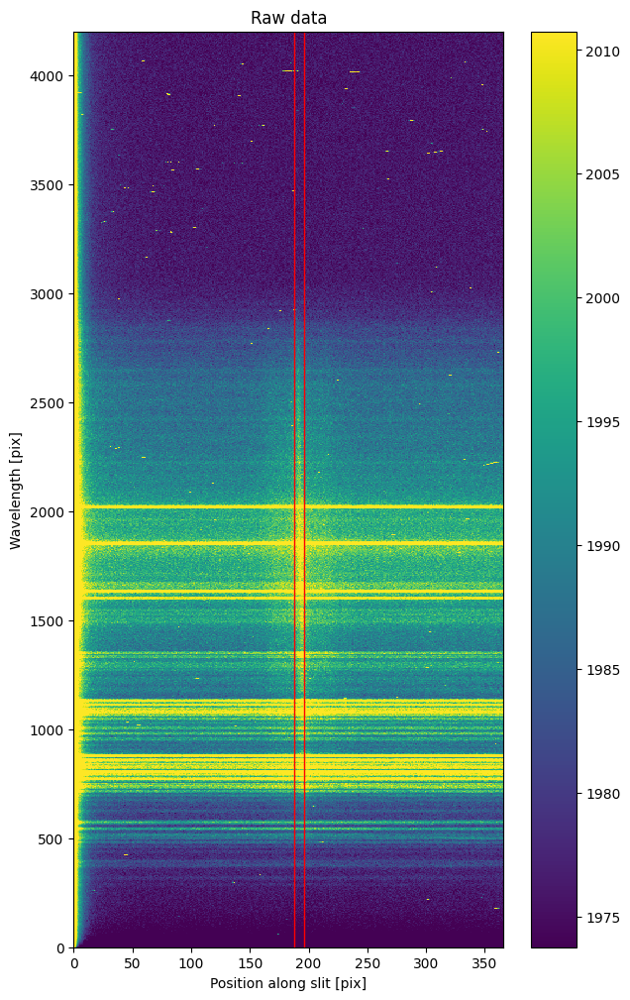

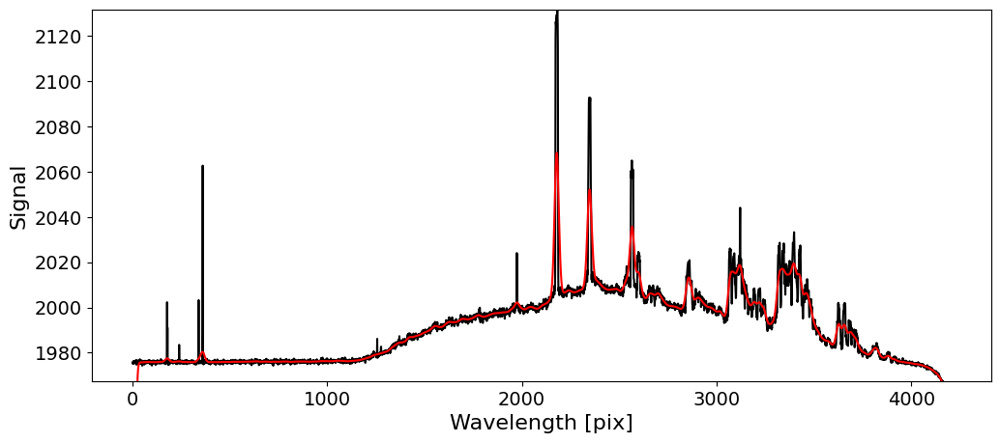

In [4]:
data = CCDData(master_science, unit=u.adu)
window = [5,13] #ideal window for on-bar 
#window = [10,18] #ideal window for off-bar
plot_ccd(data, axvlines = window)
plot_estimated_spectrum(data, window = window)

# Note: the window selected here is used here to plot the spectrum.

### Apply uncertainty

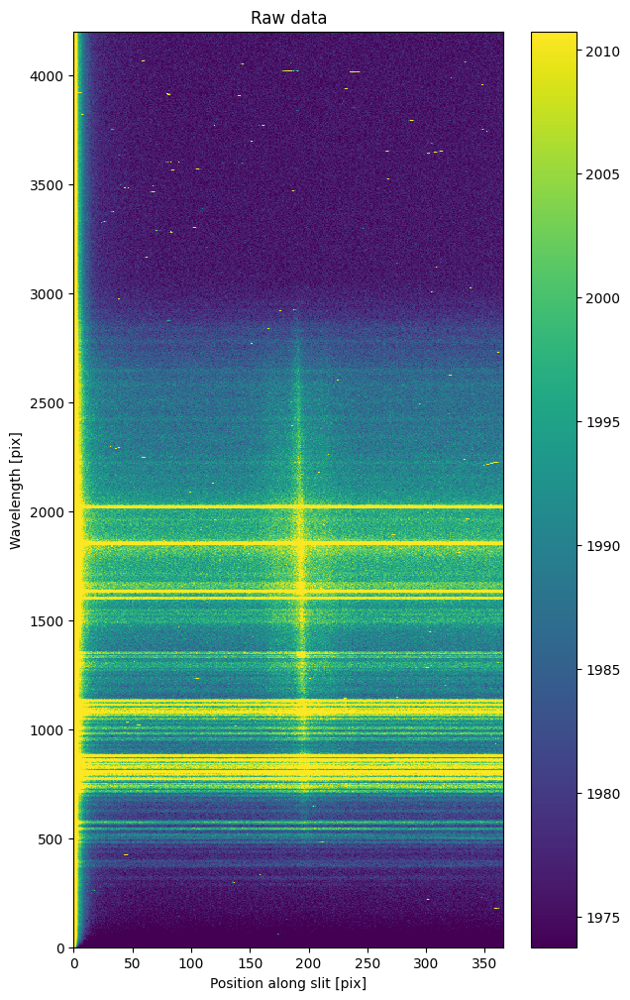

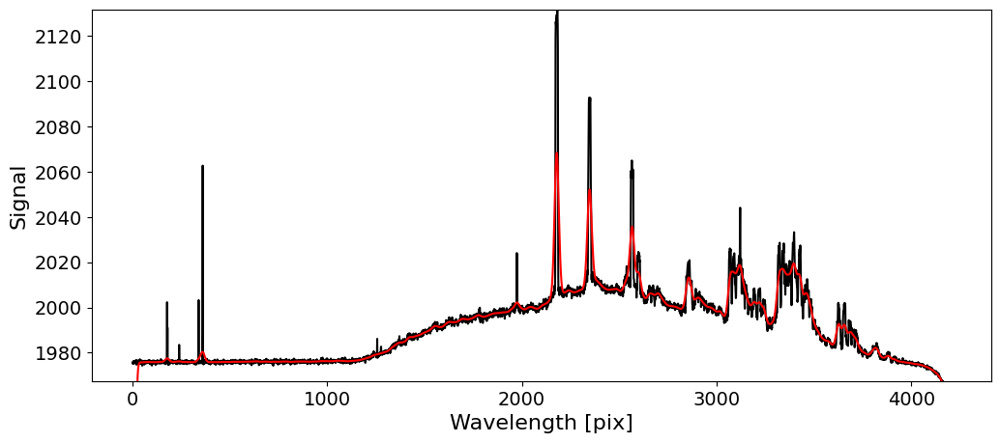

In [5]:
data = ccdproc.create_deviation(data, gain=gain * u.electron/u.adu,readnoise = readnoise * u.electron)
plot_ccd(data)
plot_estimated_spectrum(data, window = window)

### Apply gain correction

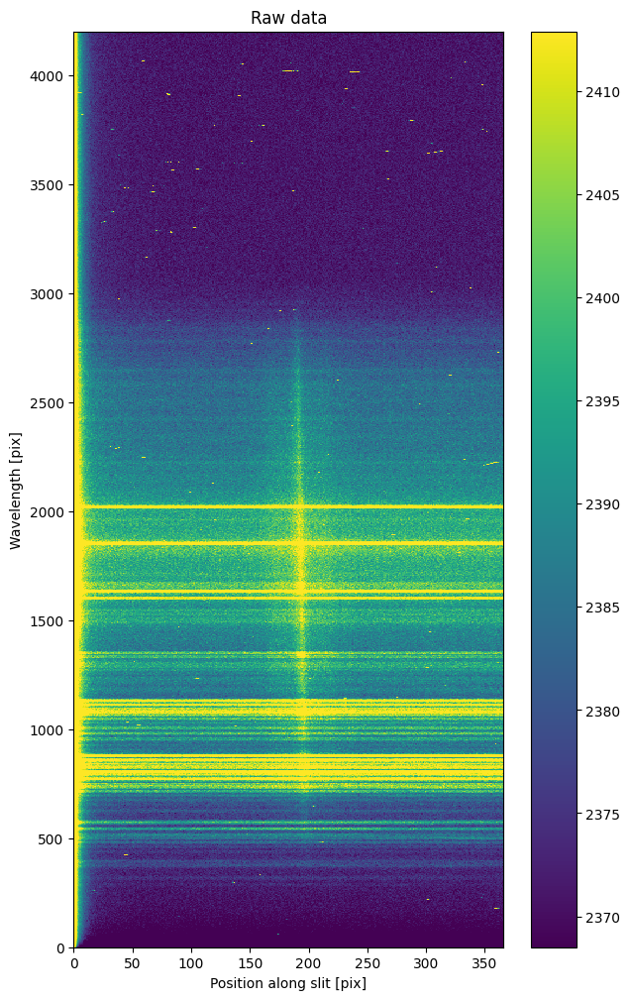

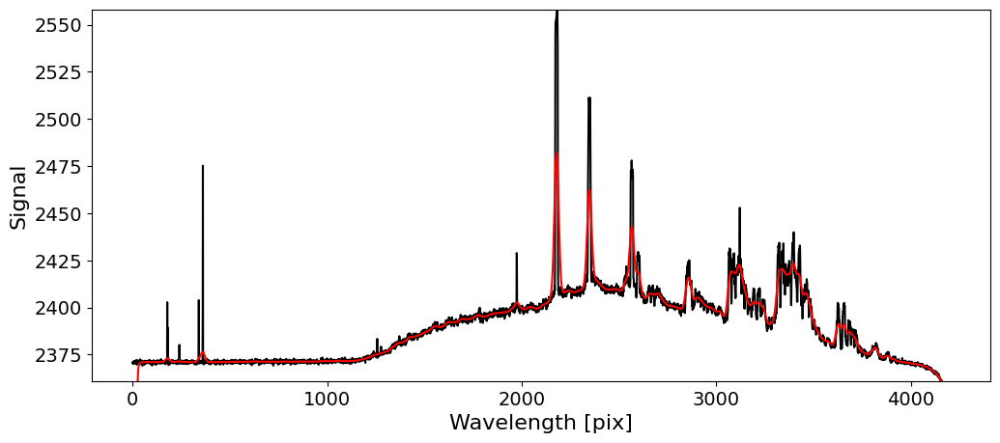

In [6]:
data = ccdproc.gain_correct(data, gain*u.electron/u.adu)
plot_ccd(data)
plot_estimated_spectrum(data, window = window)

### Subtract overscan

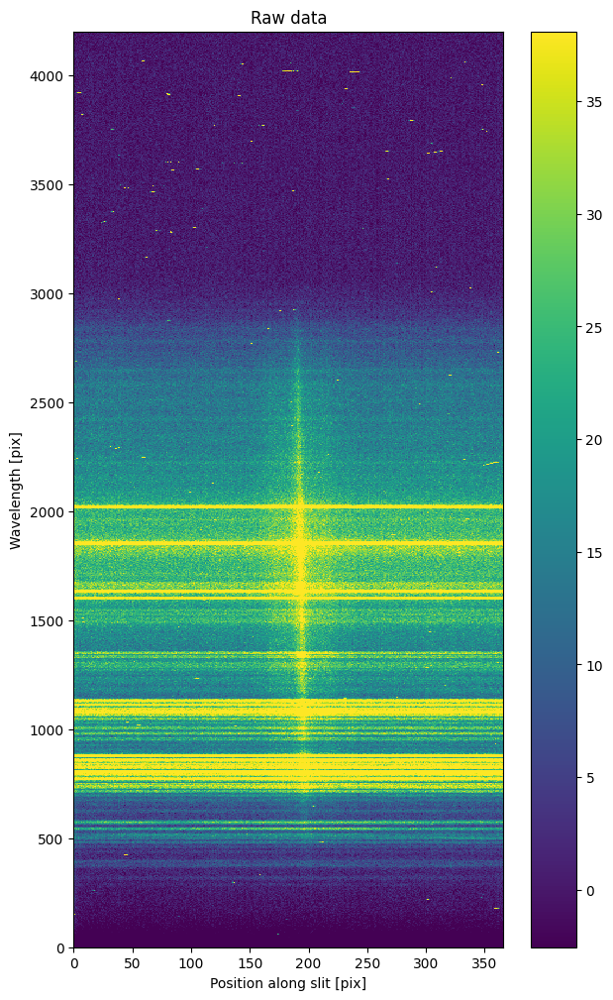

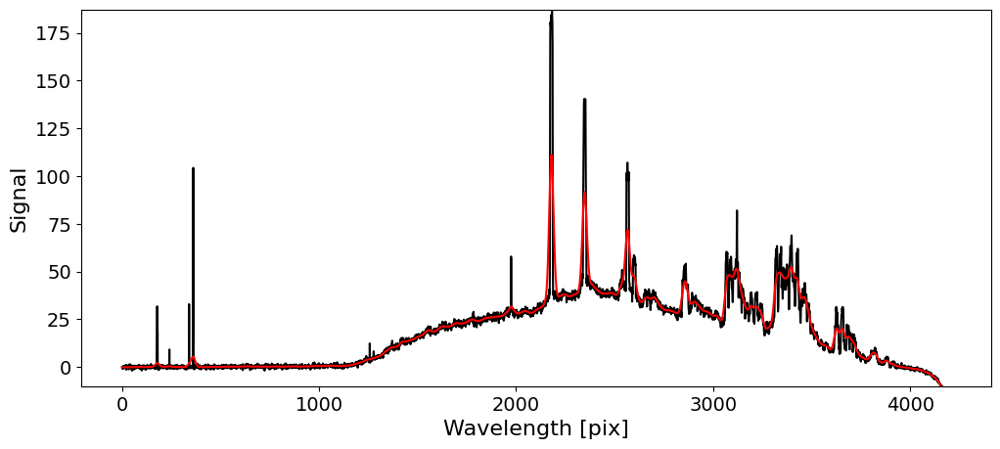

In [7]:
data = ccdproc.subtract_overscan(data, median=True,  overscan_axis=0, overscan=data[4110:4190,:])
plot_ccd(data)
plot_estimated_spectrum(data, window = window)

### Trim image

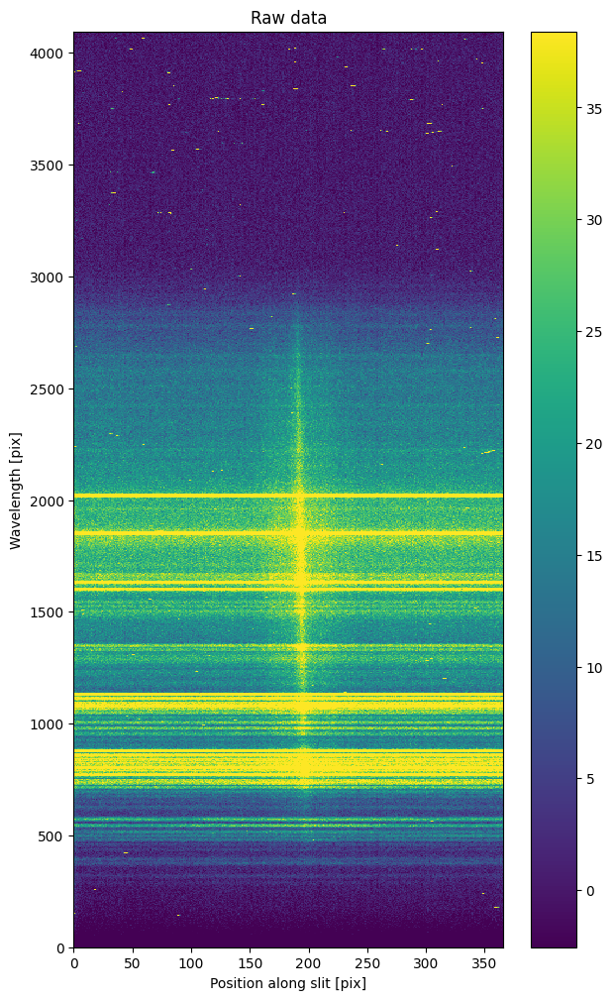

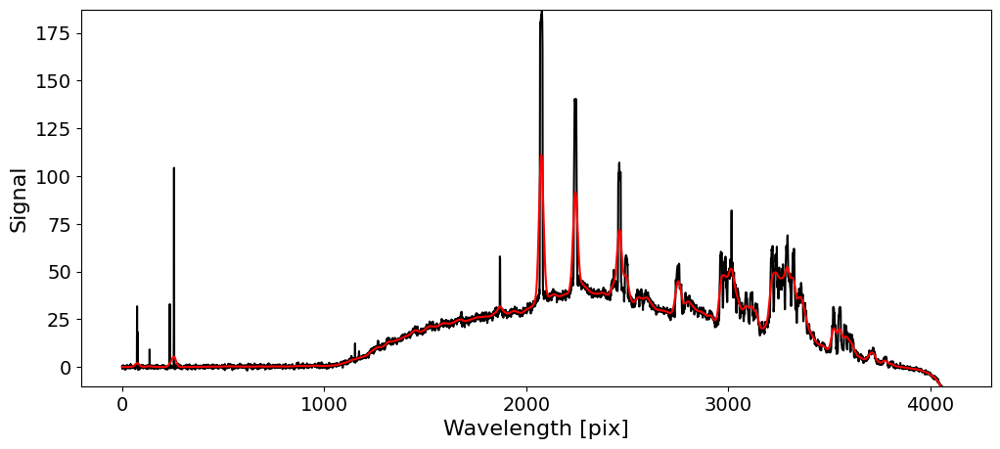

In [8]:
data = ccdproc.trim_image(data[:4096,:])
plot_ccd(data)
plot_estimated_spectrum(data, window = window)

### Subtract bias

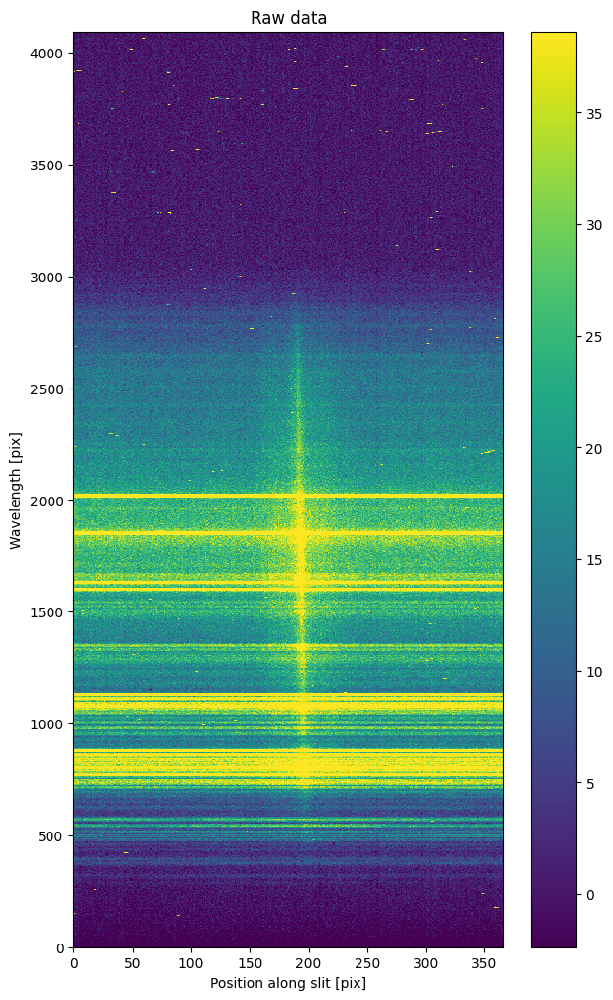

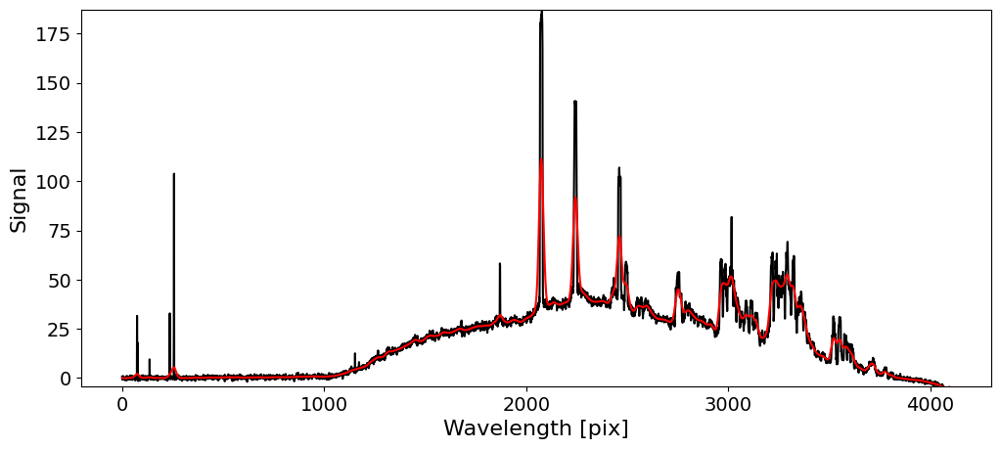

In [9]:
master_bias = CCDData(master_bias, unit=u.adu)
master_bias = ccdproc.gain_correct(master_bias, gain*u.electron/u.adu)
master_bias = ccdproc.subtract_overscan(master_bias, median=True,  overscan_axis=0, overscan=master_bias[4110:4190,:])
master_bias = ccdproc.trim_image(master_bias[:4096,:])

data_prebias = data.copy()

data = ccdproc.subtract_bias(data, master_bias)
plot_ccd(data)
plot_estimated_spectrum(data, window = window)

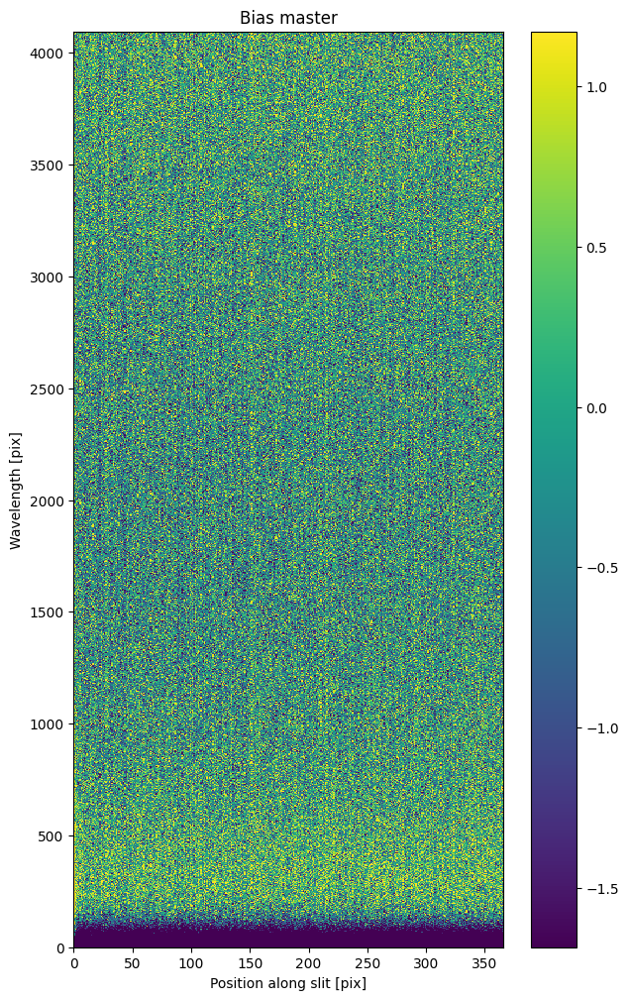

In [10]:
plot_ccd(master_bias, title = 'Bias master')

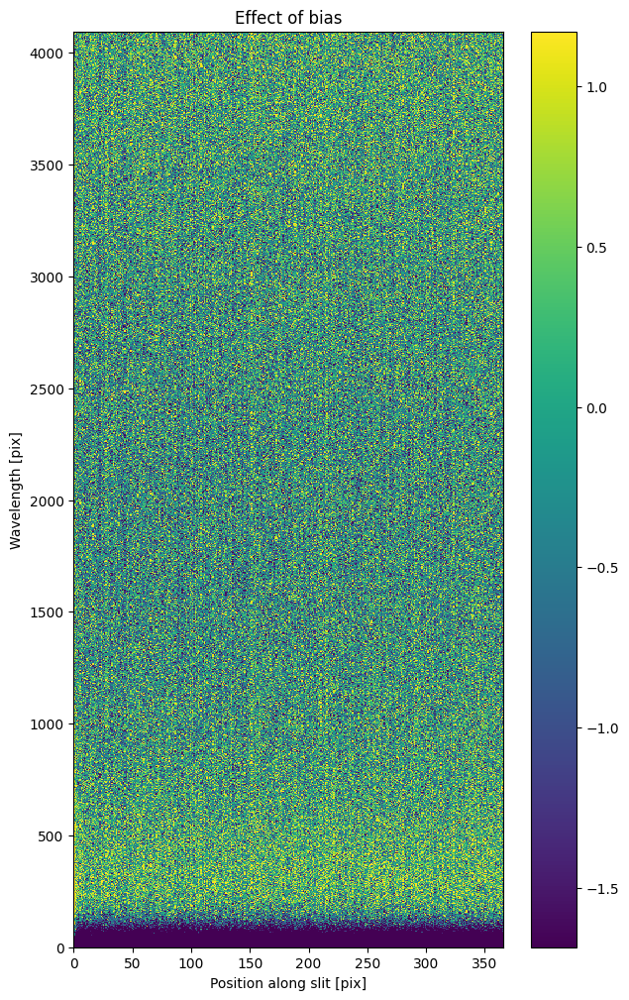

In [11]:
plot_ccd(np.array(data_prebias) - np.array(data), title = 'Effect of bias')

### Flatfield correction
Since we took the flat with a lamp, this lamp will imprint a specific shape/gradient along the wavelength axis. Therrefore, we perform a custom normalisation for every spatial column. 

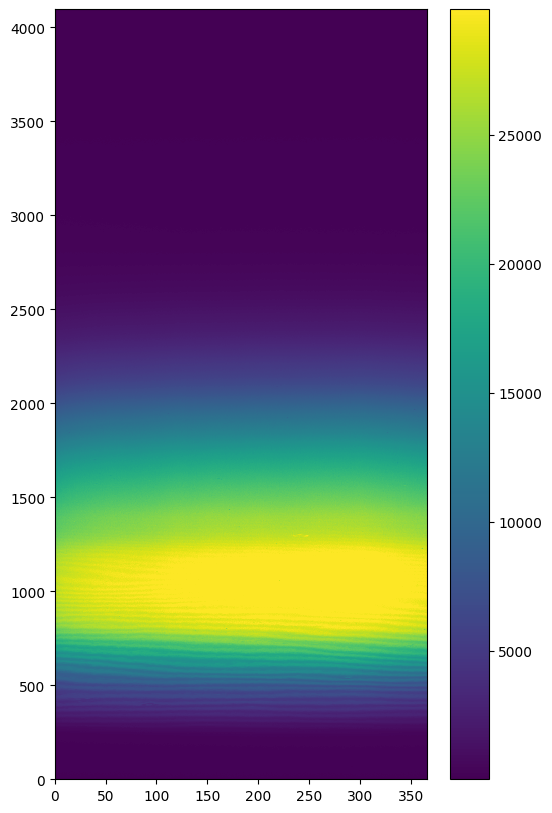

In [12]:
# http://www.starlink.ac.uk/docs/sc7.htx/sc7se4.html#x5-200016

master_flat = CCDData(master_flat, unit=u.adu)
master_flat = ccdproc.create_deviation(master_flat, gain=gain * u.electron/u.adu,readnoise = readnoise * u.electron)
master_flat = ccdproc.gain_correct(master_flat, gain*u.electron/u.adu)
master_flat = ccdproc.subtract_overscan(master_flat, median=True,  overscan_axis=0, overscan=master_flat[4110:4190,:])
master_flat = ccdproc.trim_image(master_flat[:4096,:])
master_flat = ccdproc.subtract_bias(master_flat, master_bias) 


plt.figure(figsize = (6,10))
plt.pcolormesh(np.array(master_flat),vmin = np.percentile(master_flat,1),vmax = np.percentile(master_flat,95))
plt.colorbar()
plt.show()

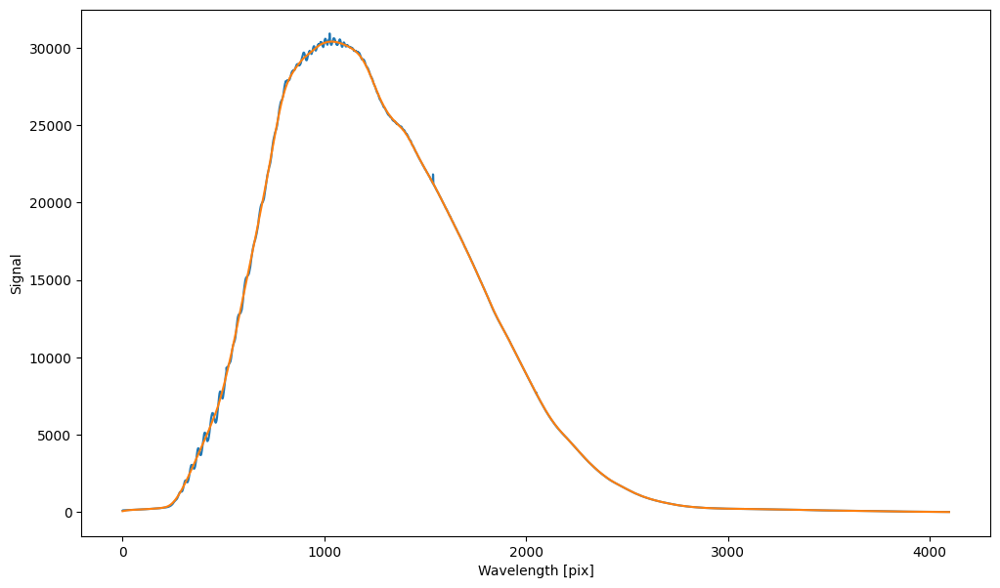

In [13]:
# Visualise flatfield
plt.figure(figsize = (12,7))
summed_flat = np.average(master_flat, axis = 1) # average the flat over spatial axis
gauss = Gaussian1DKernel(stddev=20)
smooth_flat = convolve(summed_flat, gauss)
plt.plot(range(len(summed_flat)),summed_flat)
plt.plot(range(len(summed_flat)), smooth_flat)
plt.xlabel('Wavelength [pix]')
plt.ylabel('Signal')
plt.show()

master_flat = ((np.array(master_flat).T / smooth_flat)).T
#master_flat = np.array(master_flat) / np.mean(np.array(master_flat)) #This is not needed.
master_flat = CCDData(master_flat, unit=u.electron)

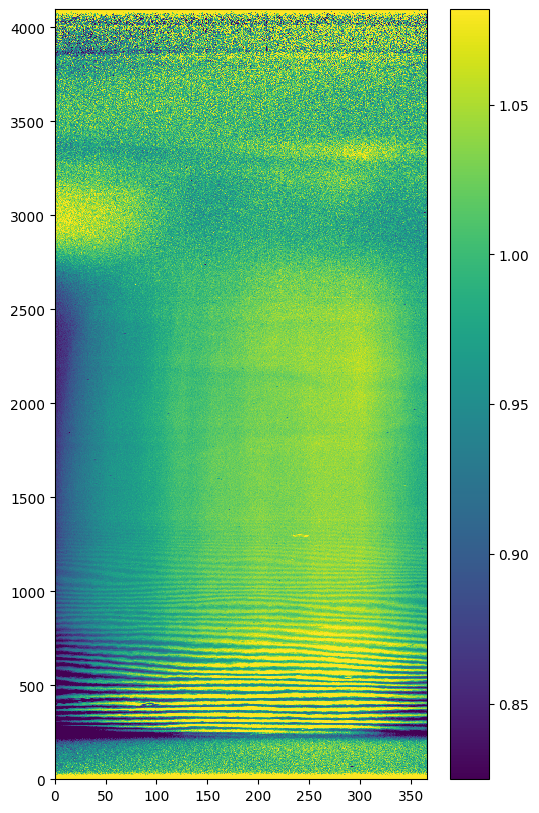

In [14]:
plt.figure(figsize = (6,10))
plt.pcolormesh(np.array(master_flat),vmin = np.percentile(master_flat,1),vmax = np.percentile(master_flat,95))
plt.colorbar()
plt.show()

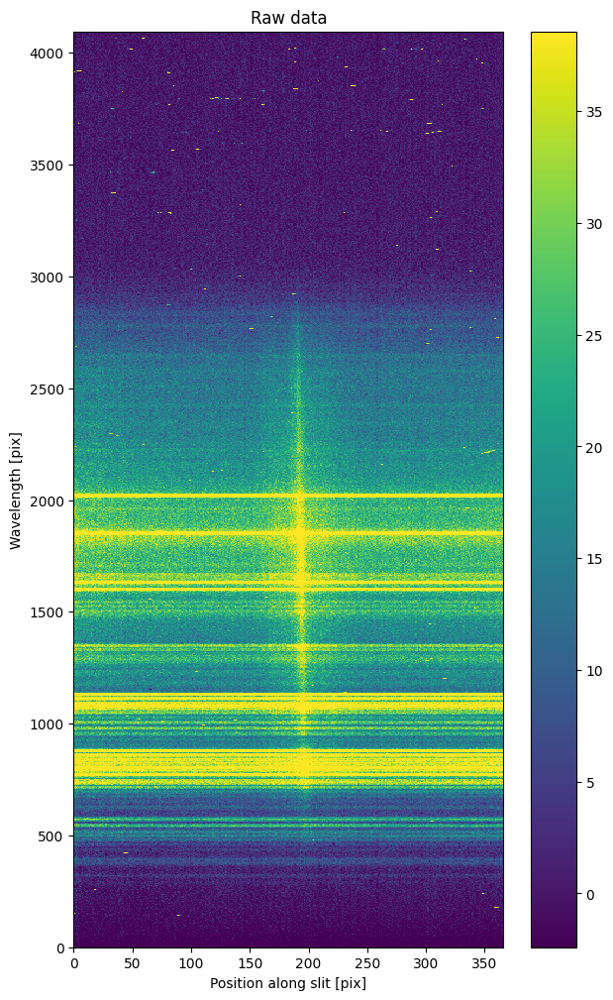

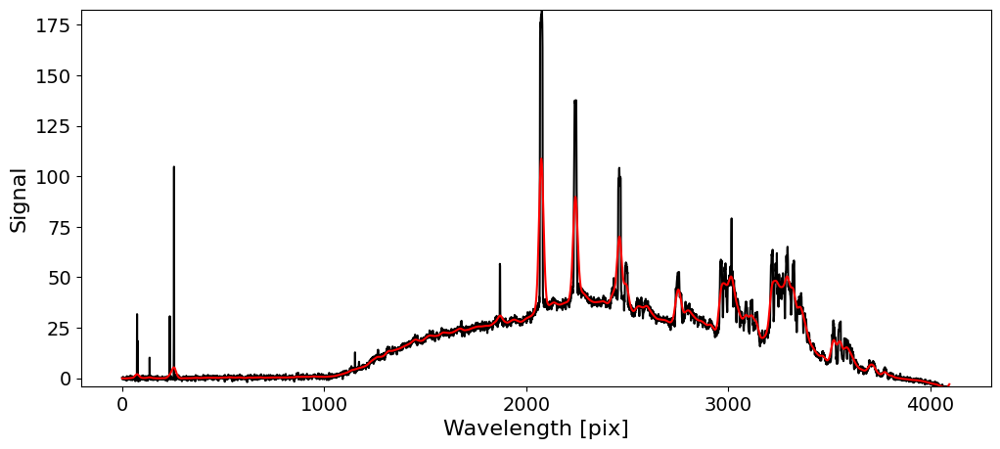

In [15]:
# Apply flatfield
data_preflat = data.copy()

data = ccdproc.flat_correct(data, master_flat, min_value=0.01)

plot_ccd(data)
plot_estimated_spectrum(data, window = window)

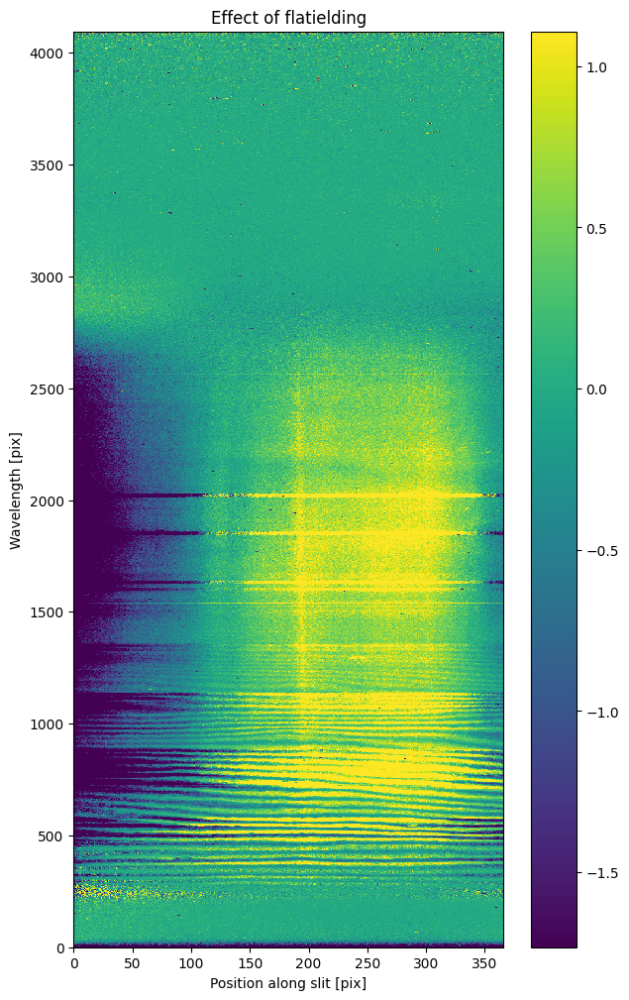

In [16]:
plot_ccd(np.array(data_preflat) - np.array(data), title = 'Effect of flatielding')

### Sky subtraction

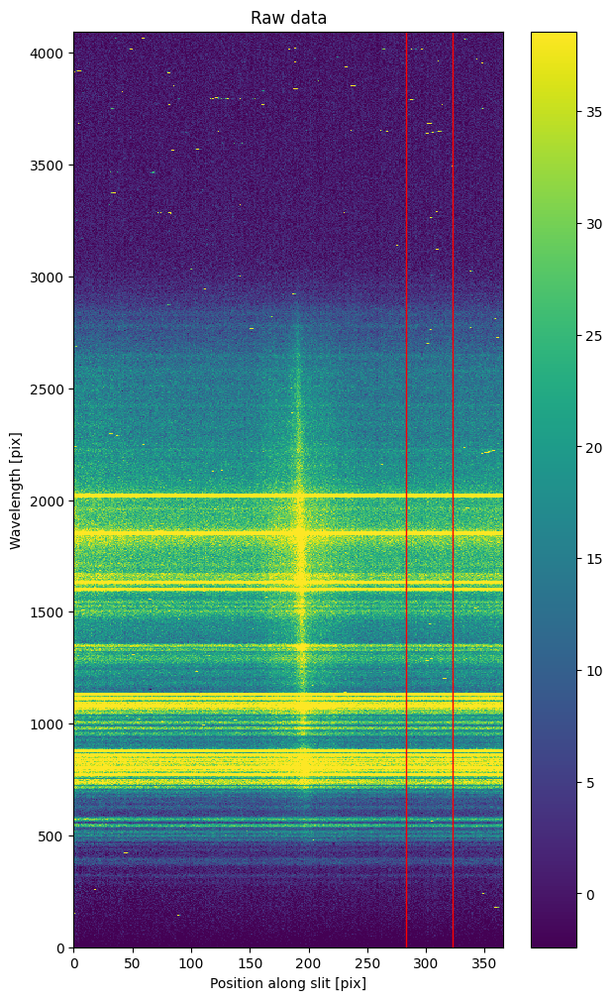

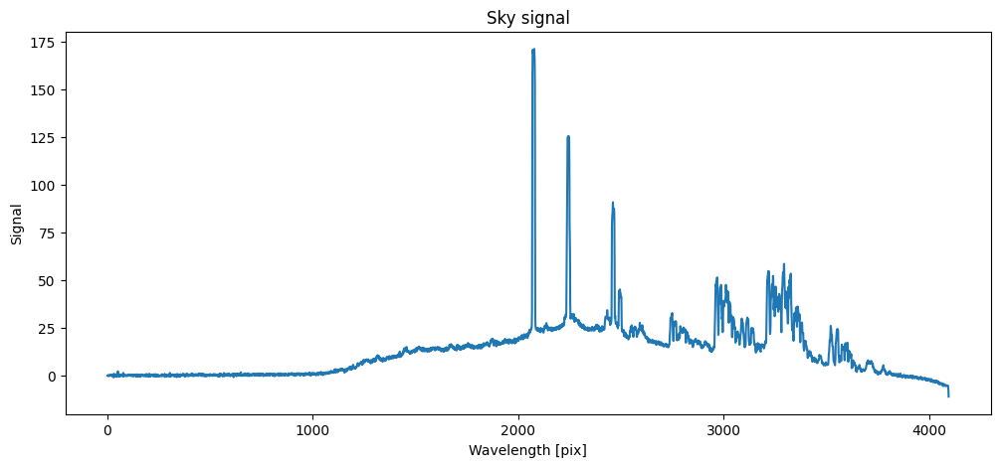

In [17]:
sky_window = [100,140] #selection window for sky subtraction

plot_ccd(data, axvlines = sky_window)

lam,slit = data.shape
mid = slit/2
sky = data[:,int(mid+sky_window[0]):int(mid+sky_window[1])]
sky = np.median(sky,axis = 1)

plt.figure(figsize = (12,5))
plt.plot(range(len(sky))[::-1],sky)
plt.xlabel('Wavelength [pix]')
plt.ylabel('Signal')
plt.title('Sky signal')
plt.show()

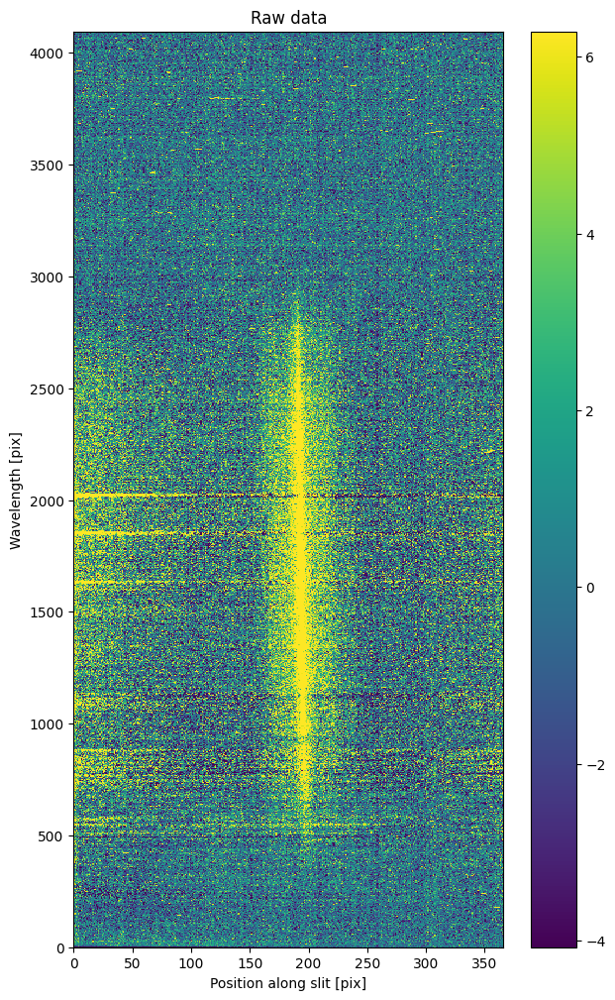

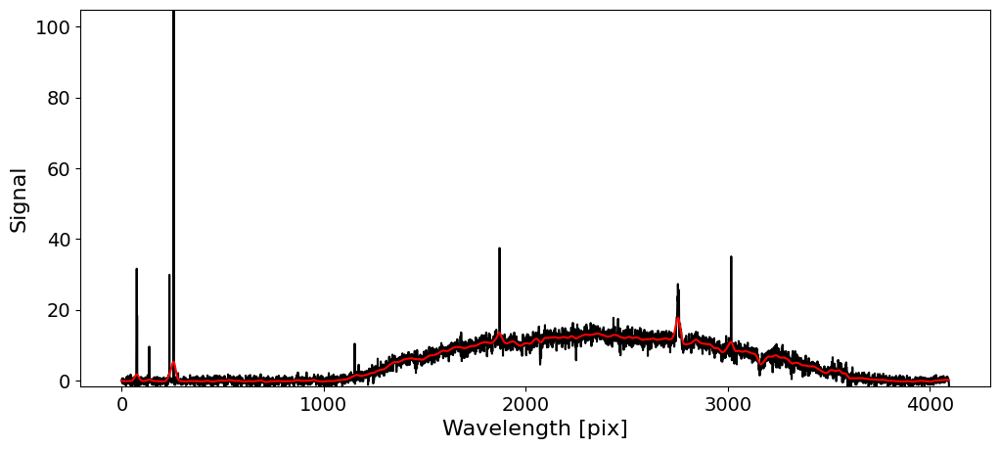

In [18]:
# Apply sky subtraction

data = (np.array(data).T - np.array(sky)).T
data = CCDData(data, unit=u.electron)

plot_ccd(data)
plot_estimated_spectrum(data, window = window)

### Rotate image?
Think about this more. 

The main vertical line of the galaxy seems slightly rotated? Is this a proble? I bet that's why the sky subtraction isn't perfect. You also see this rotation in the standard star data. Perhaps do this before subtracting sky lines?

In [19]:
stdev = 20
gauss = Gaussian2DKernel(x_stddev=stdev, y_stddev=stdev)
smoothened = convolve(np.array(data), gauss)

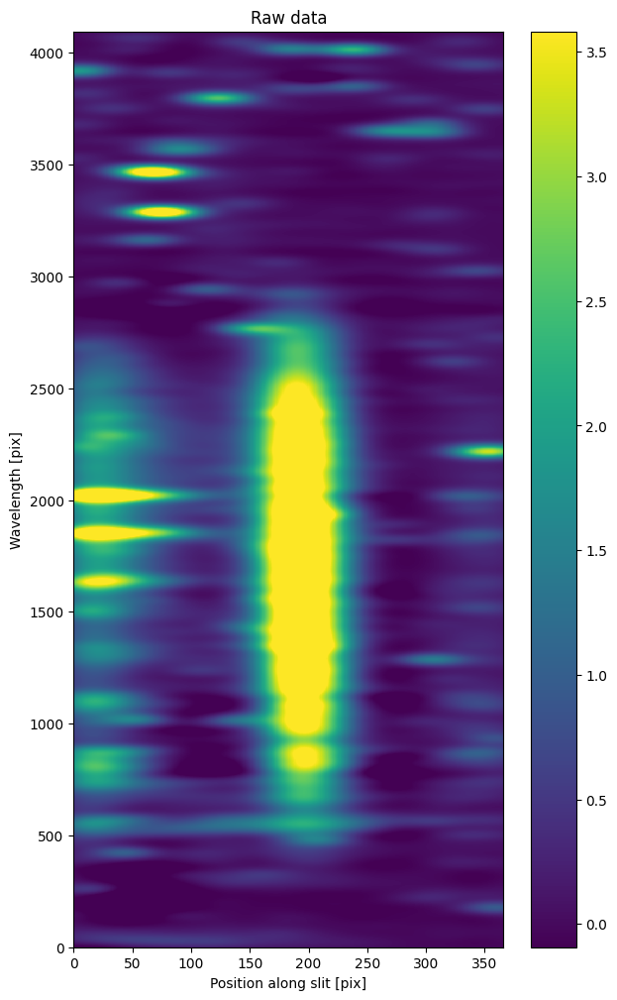

In [20]:
plot_ccd(smoothened)

In [21]:
max_idx = []
for row in smoothened:
    max_idx.append(np.argmax(np.array(row)))

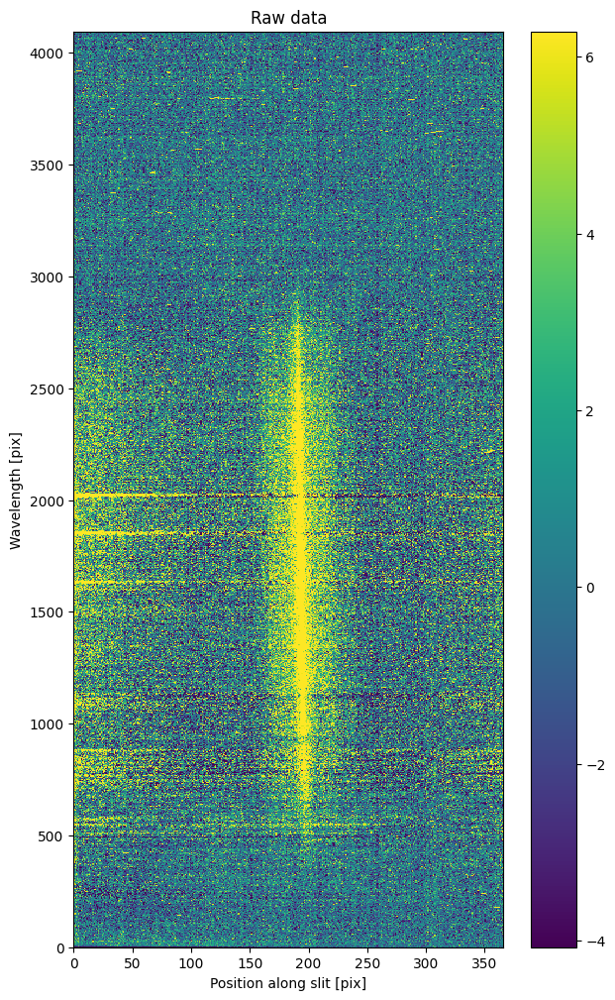

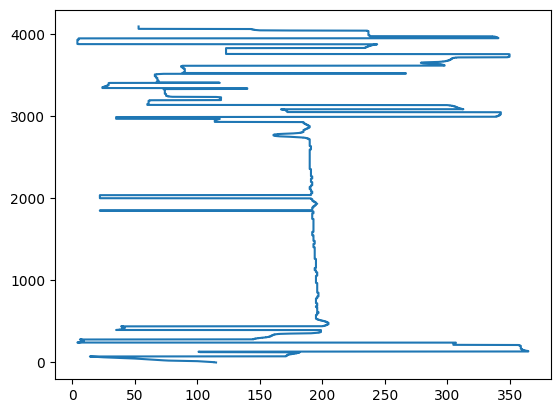

In [22]:
plot_ccd(data)
plt.plot(max_idx,range(len(np.array(data))))
plt.show()

The rotation is clearly visible between y=500 and y = 2500 ish. Should I rotate this? 

### Apply arcs

I manually went over the different arcs with different exposures and looked at which peaks at which pixel corresponds to which wavelength. I then plot a first order fit through them to estimate the conversion.

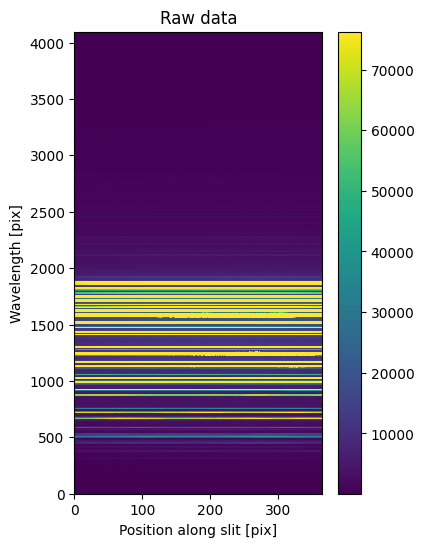

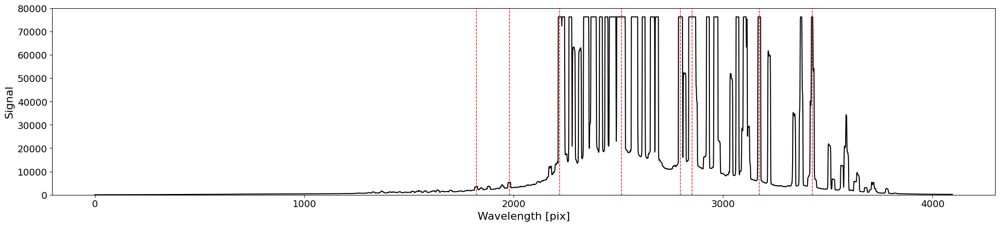

In [23]:
base_dir = 'data_telescope/20220923/'
file_numbers = [1633221]
file_numbers = [1633223]
files = [f'{base_dir}r{i}.fit' for i in file_numbers]
arc = average_data(load_data(files))

arc = CCDData(arc, unit=u.adu)
arc = ccdproc.create_deviation(arc, gain=gain * u.electron/u.adu,readnoise = readnoise * u.electron)
arc = ccdproc.gain_correct(arc, gain*u.electron/u.adu)
arc = ccdproc.subtract_overscan(arc, median=True,  overscan_axis=0, overscan=arc[4110:4190,:])
arc = ccdproc.trim_image(arc[:4096,:])
arc = ccdproc.subtract_bias(arc, master_bias) 

plot_ccd(arc, figsize = (4,6))
plot_estimated_spectrum(arc, window = window,ylims_override = [0,80000], 
                        plot_smooth = False, figsize = (25,5), axvlines = [1821, 1979, 2218, 2514, 2796, 2851, 3172, 3424],
                       sigma_clipping = False)

# Values from https://www.ing.iac.es//astronomy/observing/manuals/ps/tech_notes/tn133.pdf
# 1925 pix corresponds to 5105.54
# 2083 pix corresponds to 5400.56
# 2322 pix corresponds to 5852.49
# 2618 pix corresponds to 6402.25
# 2900 pix corresponds to 6929.47
# 2955 pix corresponds to 7032.41
# 3276 pix corresponds to 7635.11
# 3528 pix corresponds to 8115.13



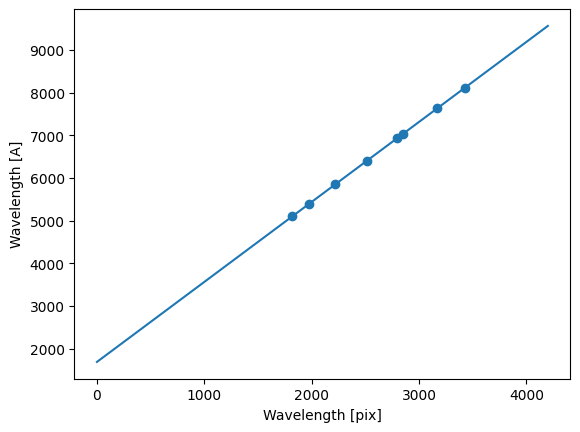

The resolution is 1.87 A/pix.


In [24]:
wavevals = [5105.54,5400.56,5852.49,6402.25,6929.47,7032.41,7635.11,8115.13] #header['CENWAVE']
pixvals = [1821, 1979, 2218, 2514, 2796, 2851, 3172, 3424] #data.shape[0]/2

plt.scatter(pixvals,wavevals)
z = np.polyfit(pixvals,wavevals,1)
p = np.poly1d(z)

xs = np.linspace(0, 4200,100)
plt.plot(xs,p(xs))
plt.xlabel('Wavelength [pix]')
plt.ylabel('Wavelength [A]')
plt.show()

print(f'The resolution is {np.round(z[0],2)} A/pix.')

# It should be 1.87: https://www.ing.iac.es/astronomy/instruments/ids/idsgrat_tables.html

In [25]:
# Apply arc conversion
spectrum = extract_spectrum(data,window)

xaxis_waveobs = p(range(len(spectrum))[::-1])
redshift = 0.0427842 # from sdss
xaxis_waveem = xaxis_waveobs / (1+redshift)


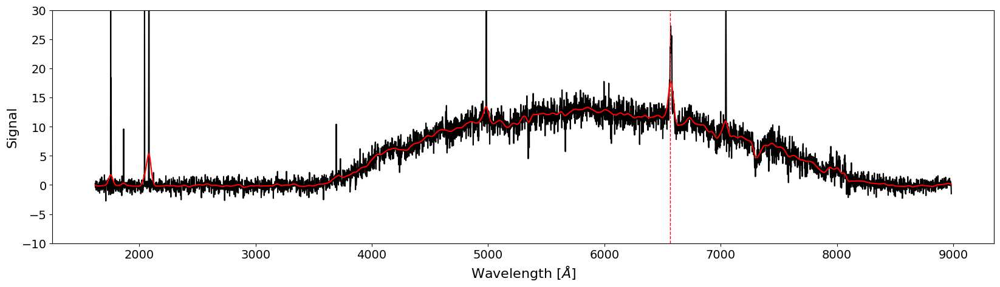

In [26]:
plot_estimated_spectrum(spectrum, window = window, xaxis = xaxis_waveem, ylims_override = [-10,30],
                       axvlines = [6564], figsize = (20,5), xlab = r'Wavelength [$\AA$]', ylab = r'Signal',
                       sigma_clipping = 10, stdev = 10)


### Flux calibration

Notes on flux calibration. The point of flux calibration is to see how counts per second on the detector translate to flux (e.g. mJy). In principle, it is easy. First, need to calculate your “response curve” (R): 

$R_{\rm response} =  F_{\rm reference, ss} / F_{\rm observed, ss}$

$F_{\rm observed, ss}$: observed spectrum of standard star (ss).
$F_{\rm reference, ss}$: reference spectrum of standard star (ss).

Then, you can use this response curve to correct your spectrum:

$F_{\rm corrected, target} = F_{\rm observed, target} * R_{\rm response}$ 

In practise, however, it quickly becomes more complicated.

In this example, I also first interpolate F_{reference, ss} so that it is at the same resolution as our data. Then, I smooth the spectra of F_{observed, ss} and F_{reference, ss}. The interpolation doesn't actually increase the resolution, so the the absorption lines that are not visible might cause some problems. Smoothening both should help.

Note that you also have to scale by the exposure times of your standard star and science image.   

You should also account for atmospheric extinction. This can be done as follows:

$F_{\rm corrected}(\lambda) = F_{\rm observed}(\lambda) \times 10^{0.4 k_{\lambda} X} $

where X is the airmass and $k_{\lambda}$ is the atmospheric extinction at that wavelength (in mag/airmass). You get X from the observing log, and $k_{\lambda}$ typically from the website of the observatory. For INT, go to: the IDS page, then under "Spectroscopic Calibration", choose flux, then "Extinction with wavelength". 

Interestingly, if you observed the standard star in a similar field of view as your science image, this correction will be identical for both, so you can effectively ignore this. However, if your standard star was observed far away at a significantly different airmass, then this does matter.


Relevant links:

See section "Spectroscopic standards" below. We should have selected standard stars from that list. Their data should be in Tech Notes 65 and 100. 
https://www.ing.iac.es/Astronomy/observing/manuals/html_manuals/tech_notes/tn085/tn085.html


For this demo, I used THE WRONG STANDARD STAR. This is because we did not actually observe one at the same night due to bad weather. I took one from another observing run at the INT. This means the flux calibration here WILL BE WRONG. The flat and arc needed for this standard star are also wrong. But the code and principles should stay the same.   

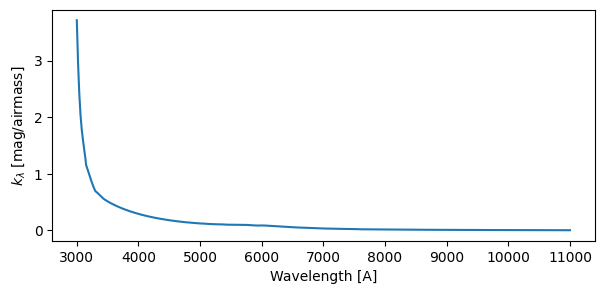

In [27]:
# Before we look at the standard stars, open and look at INT's extinction curve. 
# Obtained from: https://www.ing.iac.es/astronomy/observing/conditions/wlext.html

df_int_extinction = pd.read_csv('data_telescope/int_extinction.csv')

plt.figure(figsize = (7,3))
plt.plot(df_int_extinction['wavelength'],df_int_extinction['ext'])
plt.xlabel('Wavelength [A]')
plt.ylabel('$k_{\lambda}$ [mag/airmass]')
plt.show()


f_ext = interpolate.interp1d(df_int_extinction['wavelength'],df_int_extinction['ext'], bounds_error = False, fill_value = (np.nan,np.nan))

# We can now use f_ext as follows to get the k_lambda at any wavelength
#k_lambda = f_ext(wavelength)

In [28]:
# Standard star

#base_dir = 'data_telescope/20220923/SP2032+248/'
#file_numbers = [1688601,1688602,1688603,1688604,1688605]

base_dir = 'data_telescope/20220923/SP0146+133/'
file_numbers = [1688628,1688629]
files = [f'{base_dir}r{i}.fit' for i in file_numbers]
standard_star = average_data(load_data(files))

In [29]:
# Other parameters - change this based on the observing log

exposure_time_standard = 10 #sec
exposure_time_science = 30*60 #sec #If averaging multiple science frames, take average exp time

airmass_standard = 1.004
airmass_science = 1.2

In [30]:
standard_star = CCDData(standard_star, unit=u.adu)
standard_star = ccdproc.create_deviation(standard_star, gain=gain * u.electron/u.adu,readnoise = readnoise * u.electron)
standard_star = ccdproc.gain_correct(standard_star, gain*u.electron/u.adu)
standard_star = ccdproc.subtract_overscan(standard_star, median=True,  overscan_axis=0, overscan=standard_star[4110:4190,:])
standard_star = ccdproc.trim_image(standard_star[:4096,:])
standard_star = ccdproc.subtract_bias(standard_star, master_bias) 
standard_star = ccdproc.flat_correct(standard_star, master_flat, min_value=0.01)


# Sky subtraction
sky_window = [100,140] #selection window for sky subtraction
lam,slit = standard_star.shape
mid = slit/2
sky = standard_star[:,int(mid+sky_window[0]):int(mid+sky_window[1])]
sky = np.median(sky,axis = 1)
standard_star = (np.array(standard_star).T - np.array(sky)).T
standard_star = CCDData(standard_star, unit=u.electron)


# Arc
ss_offset = 280
xaxis_waveobs_ss = xaxis_waveobs - ss_offset # YOU SHOULDN'T HAVE TO DO THIS! 
#I only apply this because the current standard star was taken in another observing season. When it is taken during the same night,
# You can use the same arc conversion, i.e. xaxis_waveobs_ss = xaxis_waveobs
#Otherwise, you can find the offset by making sure the emission lines overlap when comparing to the template standard star spectrum below.


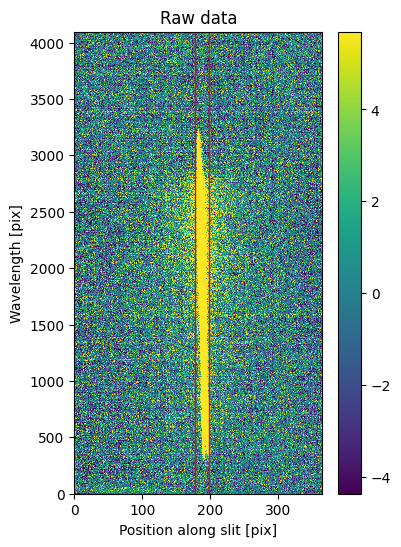

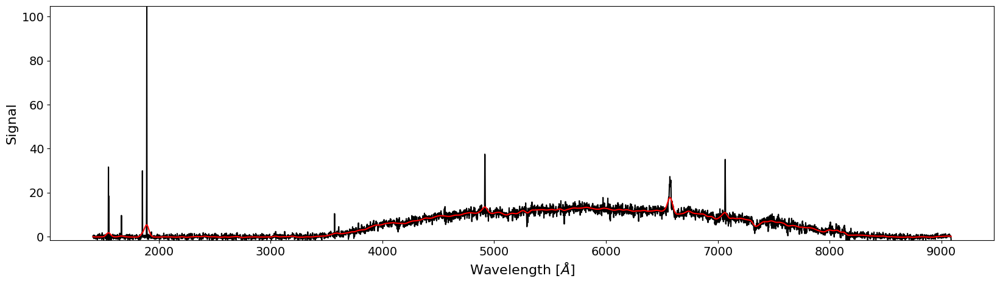

In [31]:
standard_window = [-5,15] # Make sure you select the appropriate window! We want to capture the entire star, 
#but at the same time be as narrow as possible

plot_ccd(standard_star, figsize = (4,6), axvlines = standard_window)

spectrum_standard_star = extract_spectrum(standard_star,standard_window)
plot_estimated_spectrum(spectrum, window = window, xaxis = xaxis_waveobs_ss,
                        figsize = (20,5), xlab = r'Wavelength [$\AA$]', ylab = r'Signal',
                       sigma_clipping = 10, stdev = 10)


In [32]:
# Visualise the standard star data from the INT
#df_ss = pd.read_csv('data_telescope/20220923/int_2032+248.csv')
df_ss = pd.read_csv('data_telescope/20220923/int_0146+133.csv')

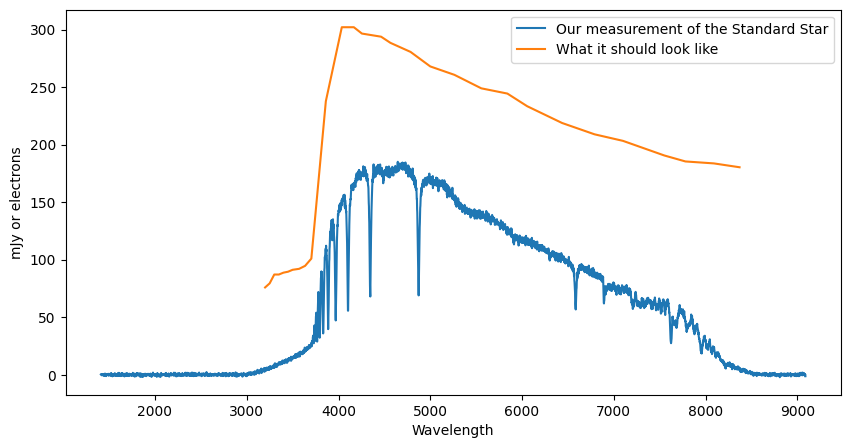

In [33]:
plt.figure(figsize = (10,5))
plt.plot(xaxis_waveobs_ss, spectrum_standard_star, label = 'Our measurement of the Standard Star')
plt.plot(df_ss['wavelength'], df_ss['mjy'], label = 'What it should look like')

plt.xlabel('Wavelength')
plt.ylabel('mJy or electrons')
plt.legend()
plt.show()

# LOOK OUT FOR the lines of the standard stars. They should overlap quite well.

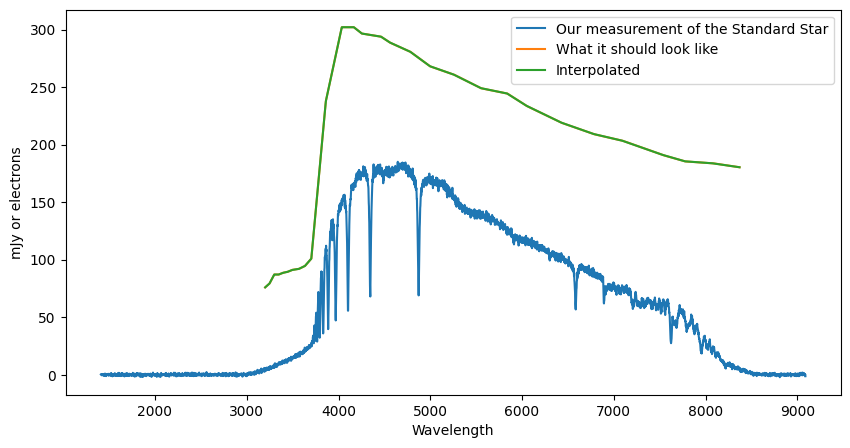

In [34]:
# Interpolate so that x-axis is the same
f = interpolate.interp1d(df_ss['wavelength'], df_ss['mjy'], bounds_error = False, fill_value = (np.nan,np.nan))
flux_interpolated_standard_star = f(xaxis_waveobs_ss)

plt.figure(figsize = (10,5))
plt.plot(xaxis_waveobs_ss, spectrum_standard_star, label = 'Our measurement of the Standard Star')
plt.plot(df_ss['wavelength'], df_ss['mjy'], label = 'What it should look like')
plt.plot(xaxis_waveobs_ss, flux_interpolated_standard_star, label = 'Interpolated')

plt.xlabel('Wavelength')
plt.ylabel('mJy or electrons')
plt.legend()
plt.show()

# Make sure the interpolation works 

In [35]:
# Create a smoothened version of the interpolated INT's version of the standard star
stddev_standard_star = 80 #DEPENDS ON RESOLTION. SO ADJUST THIS AS NEEDED.
gauss = Gaussian1DKernel(stddev=stddev_standard_star)
smooth_standard_int = convolve(flux_interpolated_standard_star, gauss, boundary = 'extend')


# Create a smoothened version of our standard star
stddev_standard_star = 80 #DEPENDS ON RESOLTION. SO ADJUST THIS AS NEEDED.
gauss = Gaussian1DKernel(stddev=stddev_standard_star)
smooth_standard_our = convolve(spectrum_standard_star, gauss, boundary = 'extend')

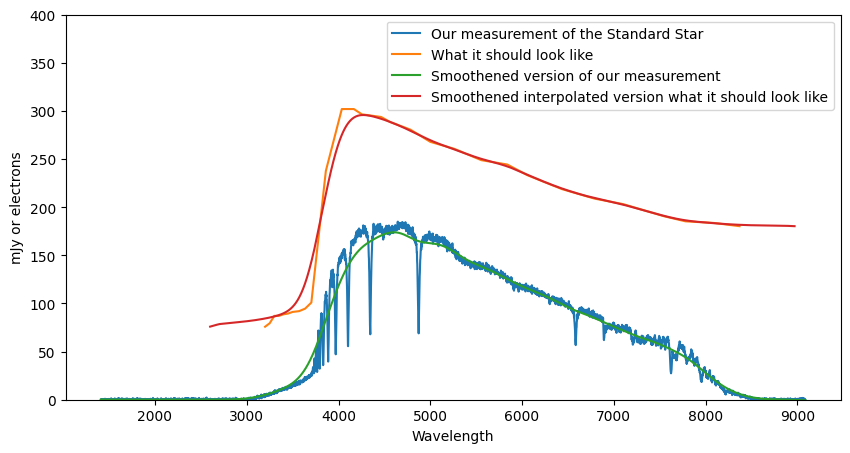

In [36]:
plt.figure(figsize = (10,5))
plt.plot(xaxis_waveobs_ss, spectrum_standard_star, label = 'Our measurement of the Standard Star')
plt.plot(df_ss['wavelength'], df_ss['mjy'], label = 'What it should look like')
plt.plot(xaxis_waveobs_ss,smooth_standard_our, label ='Smoothened version of our measurement')
plt.plot(xaxis_waveobs_ss,smooth_standard_int, label = 'Smoothened interpolated version what it should look like')


plt.xlabel('Wavelength')
plt.ylabel('mJy or electrons')
plt.legend()
plt.ylim(0,400) # Adjust as needed
plt.show()

# LOOK OUT FOR the lines of the standard stars. They should overlap quite well.

In [37]:
response_curve =   smooth_standard_int / (smooth_standard_our)

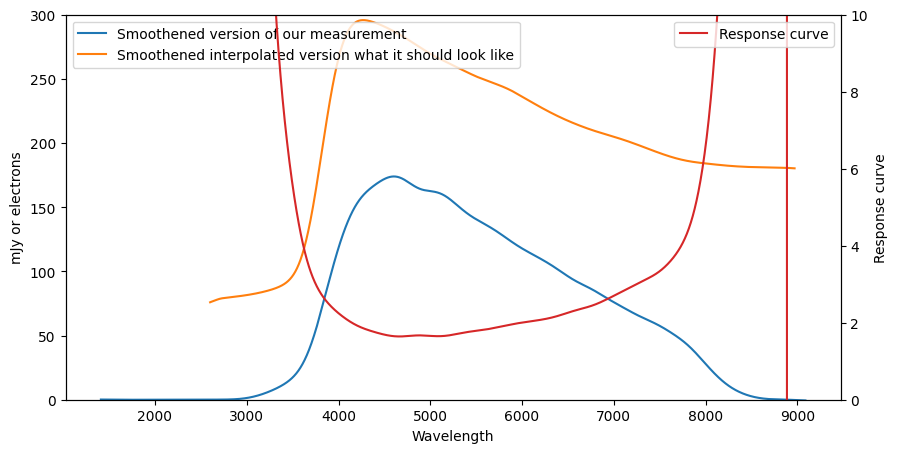

In [38]:
plt.figure(figsize = (10,5))

plt.plot(xaxis_waveobs_ss,smooth_standard_our, label ='Smoothened version of our measurement')
plt.plot(xaxis_waveobs_ss,smooth_standard_int, label = 'Smoothened interpolated version what it should look like')
plt.legend(loc='upper left')
plt.xlabel('Wavelength')
plt.ylabel('mJy or electrons')

plt.ylim(0,300) #Adjust this as needed

ax = plt.gca().twinx()
ax.plot(xaxis_waveobs_ss, response_curve, c = 'C3', label = 'Response curve')
ax.set_ylabel('Response curve')
plt.legend(loc = 'upper right')
plt.ylim(0,10)
plt.show()

# Things to look out for: response curve is <1 when our measurement is larger than the reference, and the other way around. 

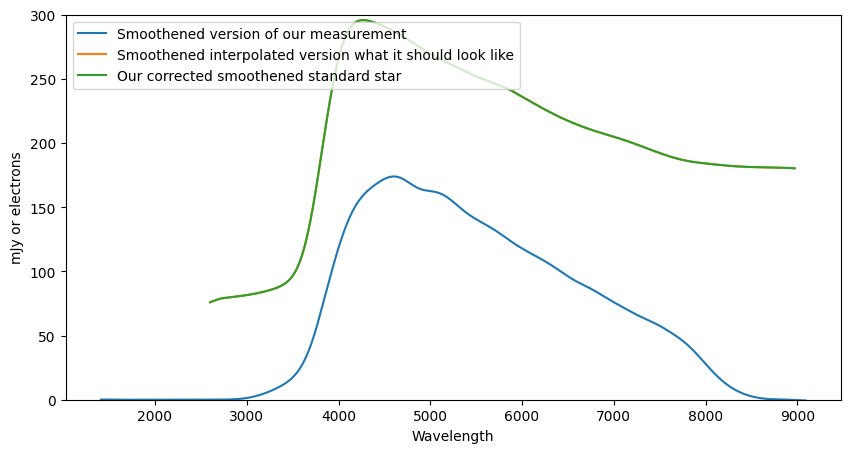

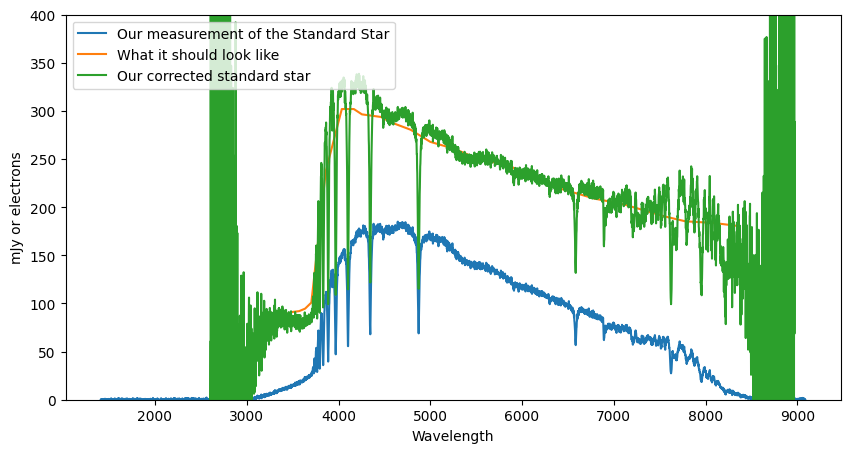

In [39]:
# See if reponse curve works by using it on our measurement of the standard star

# First, try on smoothened version

corrected = smooth_standard_our*response_curve * exposure_time_standard/exposure_time_standard
# NOTE: We're just multiplying by the response curve, and scaling by exposure time. Since we're applying this on the 
# standard star, the exposure time ratio = 1. 

# NOTE 2: Because we're applying this on the standard star, we're ignoring the atmospheric extinction, since the 
# airmass should be identical. This will change below, though, when applying the response curve on the science image

plt.figure(figsize = (10,5))
plt.plot(xaxis_waveobs_ss,smooth_standard_our, label ='Smoothened version of our measurement')
plt.plot(xaxis_waveobs_ss,smooth_standard_int, label = 'Smoothened interpolated version what it should look like')
plt.plot(xaxis_waveobs_ss,corrected, label ='Our corrected smoothened standard star')

plt.ylim(0,300)#Adjust this as needed
plt.legend(loc='upper left')
plt.xlabel('Wavelength')
plt.ylabel('mJy or electrons')
plt.show()


# Now let's try it on the unsmoothened standard star

corrected = spectrum_standard_star*response_curve * exposure_time_standard/exposure_time_standard
# NOTE: We're just multiplying by the response curve, and scaling by exposure time. Since we're applying this on the 
# standard star, the exposure time ratio = 1. 

# NOTE 2: Because we're applying this on the standard star, we're ignoring the atmospheric extinction, since the 
# airmass should be identical. This will change below, though, when applying the response curve on the science image

plt.figure(figsize = (10,5))
plt.plot(xaxis_waveobs_ss, spectrum_standard_star, label = 'Our measurement of the Standard Star')
plt.plot(df_ss['wavelength'], df_ss['mjy'], label = 'What it should look like')
plt.plot(xaxis_waveobs_ss,corrected, label ='Our corrected standard star')

plt.ylim(0,400)#Adjust this as needed
plt.legend(loc='upper left')
plt.xlabel('Wavelength')
plt.ylabel('mJy or electrons')
plt.show()


# There might be some craziness at the edges, where the response curve is super high. That is expected.

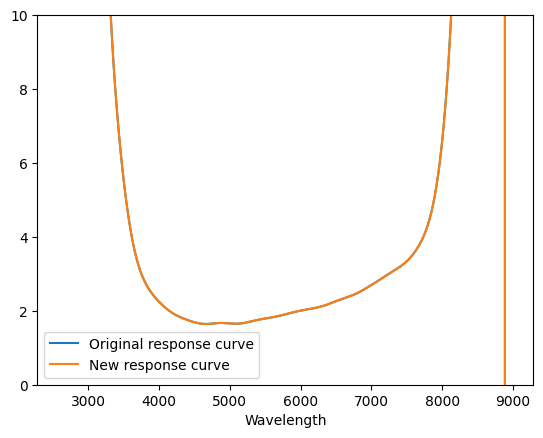

In [40]:
#Before we can use the response curve on our actual data, we need to resample it back to its original wavelength range. 
# If you remember, we offset the standard star wavelength by some amount ss_offset, becasue it was observed in a different season
#If you observed it during the same night, then ss_offset = 0 (at least in principle), and you can skip this section.

# Interpolate so that x-axis is the same
f = interpolate.interp1d(xaxis_waveobs_ss, response_curve, bounds_error = False, fill_value = (np.nan,np.nan))
response_curve_updated = f(xaxis_waveobs)


# Check if they are the same
plt.plot(xaxis_waveobs_ss,response_curve, label ='Original response curve')
plt.plot(xaxis_waveobs,response_curve_updated, label ='New response curve')
plt.ylim(0,10)
plt.xlabel('Wavelength')
plt.legend()
plt.show()

In [41]:
# If they are the same, then:
response_curve = response_curve_updated

# And you can now use it in combination with xaxis_waveobs, instead of xaxis_waveobs_ss

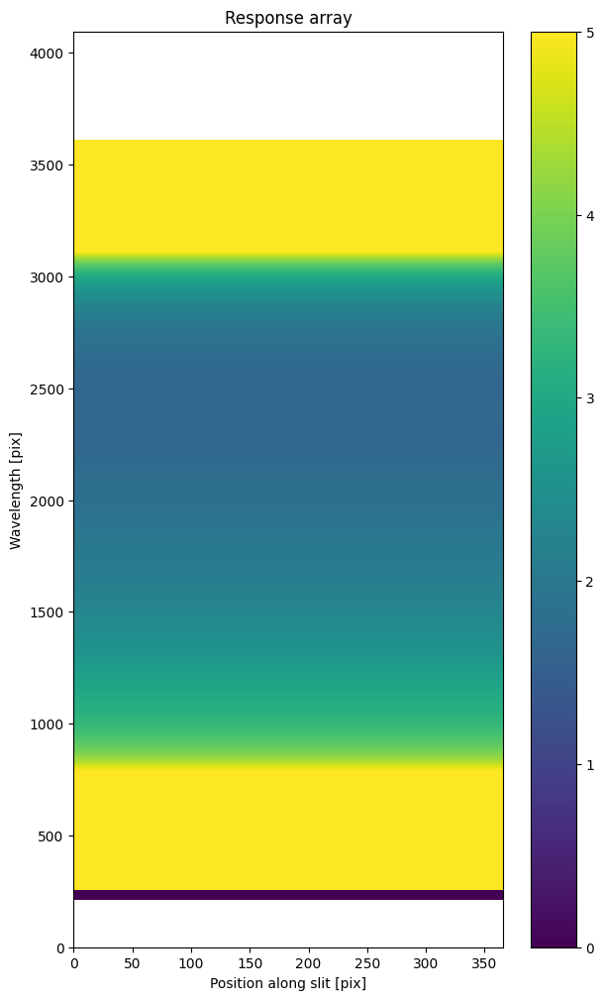

In [42]:
# Create a "response array" that you can just multiply with the original ccd.
response_array = np.repeat(np.array(response_curve)[:, np.newaxis], data.shape[1], axis=1)

plot_ccd(response_array, vmin = 0, vmax = 5, title = 'Response array')
# Some things to look out for:
# 1) There might be some "NaN"s at the edges. They appeared because the reference standard star wavelength range didn't cover the entire
# range we needed. Oh well.
# 2) It might explode to high values near the edges. This is what we saw above as well, and is expected.

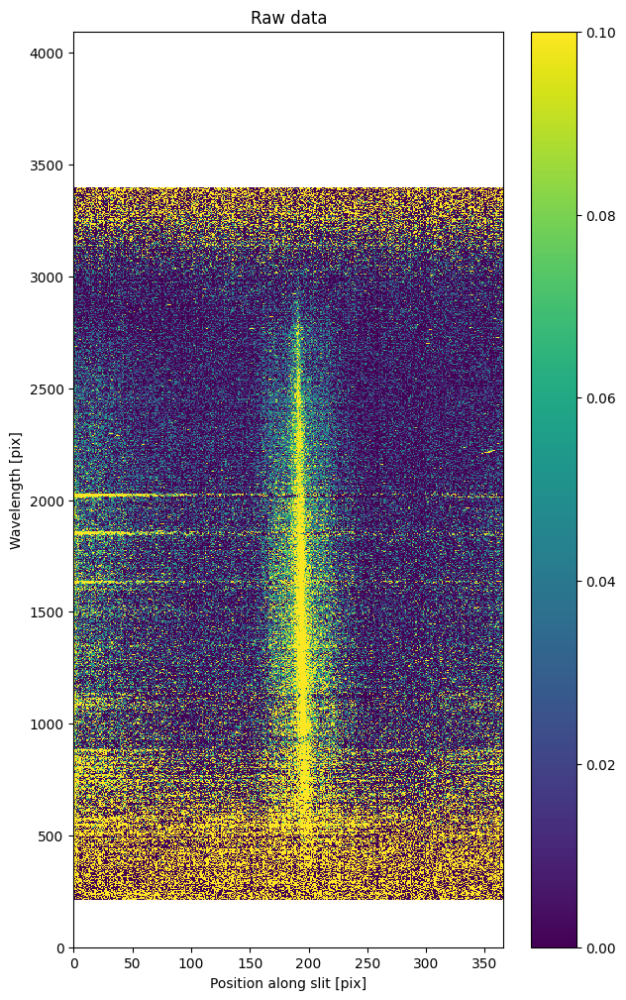

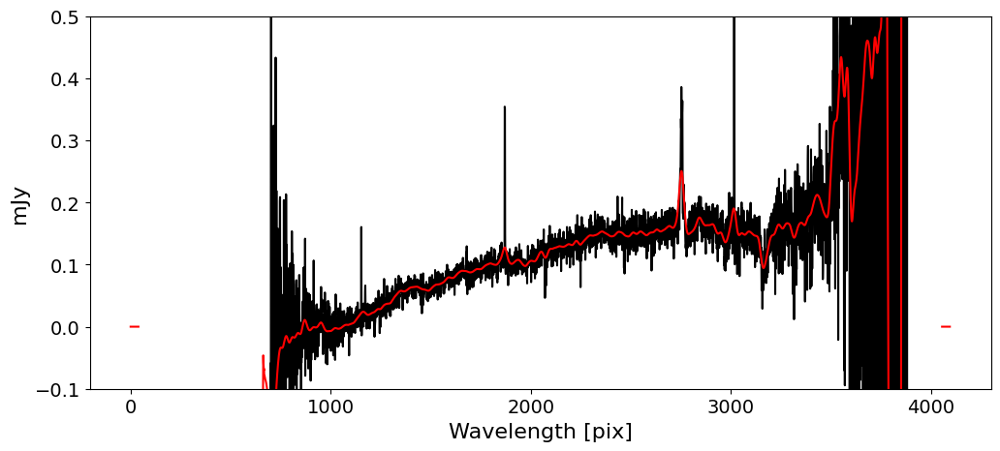

In [43]:
data_prefluxcal = data.copy() #Save so I can check effect later


# Do the actual flux calibration. Don't forget to scale by exposure time 
# and account for atmospheric extinction when airmass differs
extinction_ratio = 10**(0.4 * f_ext(xaxis_waveobs) * (airmass_science - airmass_standard)) #Make sure this equation makes sense
data = data * response_array * exposure_time_standard/exposure_time_science * extinction_ratio[:,np.newaxis]


plot_ccd(data, vmin = 0, vmax = 0.1) #adjust vmin and vmax as needed.
plot_estimated_spectrum(data, window = window, ylims_override = [-0.1,0.5], ylab = 'mJy')

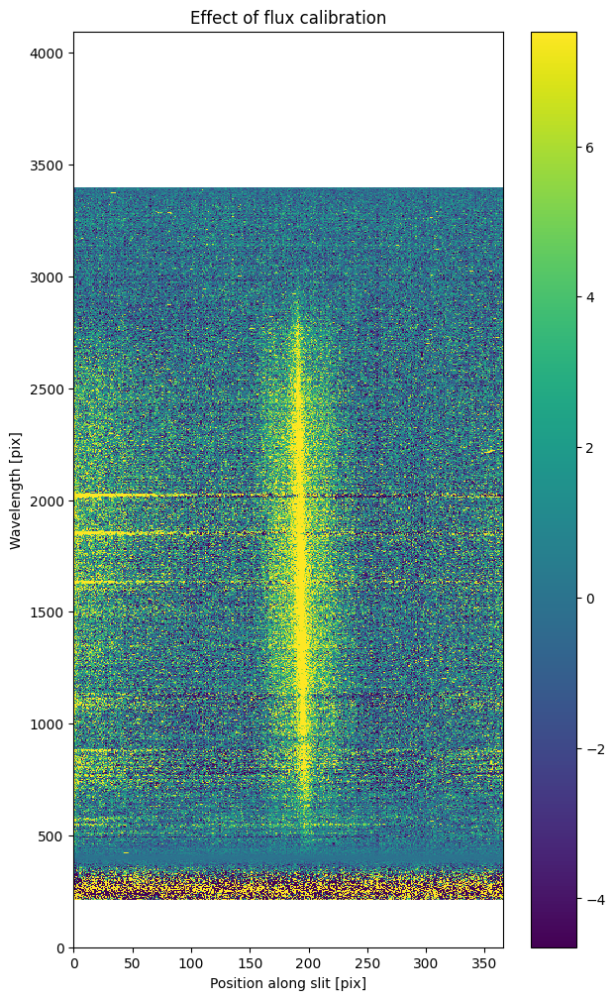

In [44]:
plot_ccd(np.array(data_prefluxcal) - np.array(data), title = 'Effect of flux calibration')

In [45]:
# Sanity check. You can convert mJy to magnitudes relatively easy using Astropy. See if the mJy you obtain here
# roughly correponds to the value in our master file. It won't be exactly the same, but should be roughly in the 
# same order of magnitude
(0.3*u.mJy).to(u.ABmag).value

np.float64(17.707196863200842)

### Trim again?

The flux calibration blows up some values near the edges of the ccd. Remove those again, because they are not useful.

### Normalisation / Blaze correction
See e.g. : http://www.starlink.ac.uk/docs/sc7.htx/sc7se4.html#x5-200016 


TODO: Instead of doing this just for the spectrum, you probably want to do this for the entire 2D array. I.e., for each position along the slit, fit continuum model, and subtract that. The final data product should be a 2D array. 

In [46]:
spectrum = extract_spectrum(data,window)
stdev = 100
gauss = Gaussian1DKernel(stddev=stdev)
blaze = convolve(spectrum, gauss)


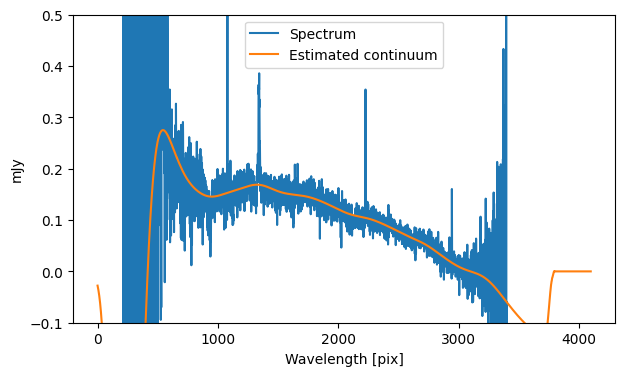

In [47]:
plt.figure(figsize = (7,4))
plt.plot(spectrum, label = 'Spectrum')
plt.plot(blaze, label = 'Estimated continuum')

plt.ylabel('mJy')
plt.xlabel('Wavelength [pix]')

plt.legend()
plt.ylim(-0.1,0.5)
plt.show()

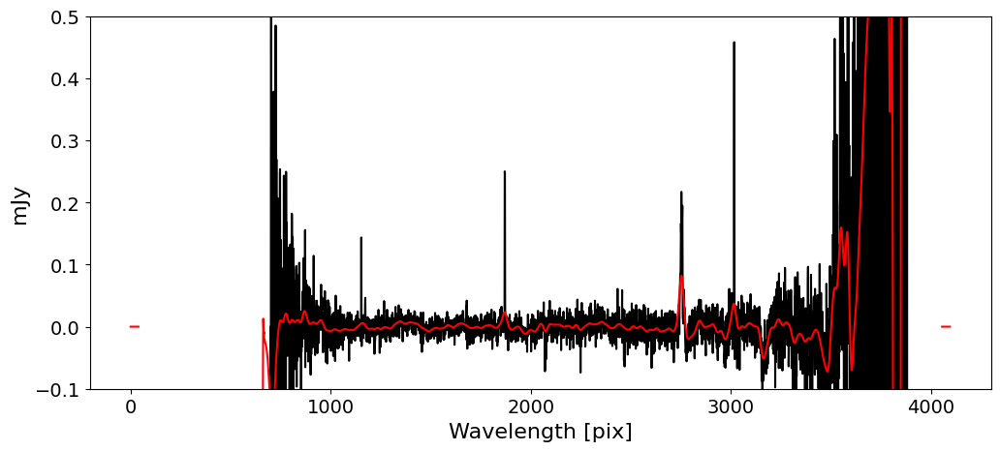

In [48]:
spectrum = spectrum - blaze
plot_estimated_spectrum(spectrum, window = window, ylims_override = [-0.1,0.5], ylab = 'mJy')

# Final spectrum

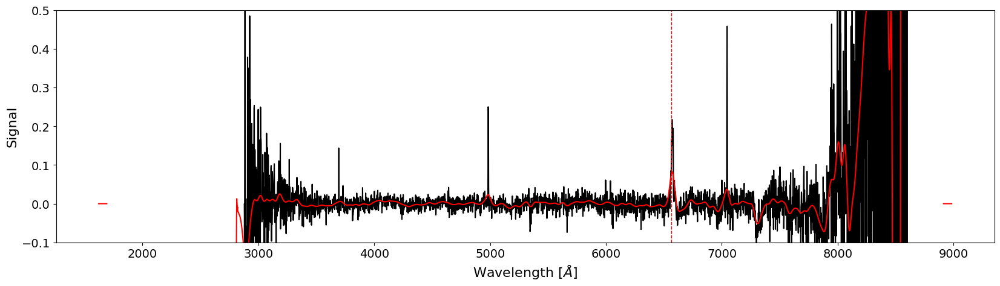

In [49]:

plot_estimated_spectrum(spectrum, window = window, xaxis = xaxis_waveem, ylims_override = [-0.1,0.5],
                       axvlines = [6564], figsize = (20,5), xlab = r'Wavelength [$\AA$]', ylab = r'Signal',
                       sigma_clipping = 10, stdev = 10)



### Calculate SNR of Halpha line

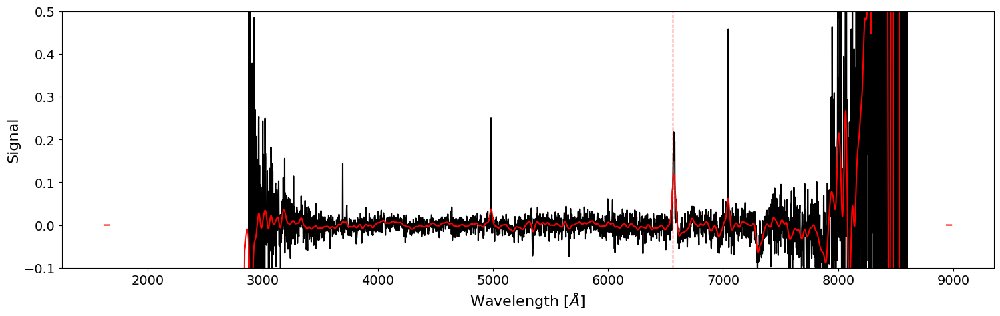

The SNR of Halpha is ~4.7. Signal is ~0.12, noise is ~0.03.


In [50]:
stdev = 6
gauss = Gaussian1DKernel(stddev=stdev)
spectrum_smooth = convolve(spectrum, gauss)

plot_estimated_spectrum(spectrum, window = window, xaxis = xaxis_waveem, stdev = stdev,figsize = (18,5), ylims_override = [-0.1,0.5],
                       axvlines = [6564], xlab = r'Wavelength [$\AA$]')

SNR, signal, noise = snr(xaxis_waveem, spectrum_smooth, spectrum, target = 6564, window = 50)
print(f'The SNR of Halpha is ~{np.round(SNR,2)}. Signal is ~{np.round(signal,2)}, noise is ~{np.round(noise,2)}.')